In [2]:
library(Signac)
library(Seurat)
library(EnsDb.Mmusculus.v79)
library(GenomeInfoDb)
library(ggplot2)
library(patchwork)
set.seed(1234)

Attaching SeuratObject

필요한 패키지를 로딩중입니다: ensembldb

필요한 패키지를 로딩중입니다: BiocGenerics


다음의 패키지를 부착합니다: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


필요한 패키지를 로딩중입니다: GenomicRanges

필요한 패키지를 로딩중입니다: stats4

필요한 패키지를 로딩중입니다: S4Vectors


다음의 패키지를 부착합니다: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    expand.grid, I, unname


필요한 패키지를 로딩중입니다: IRanges

필요한 패키지를 로딩중입니다: GenomeInfoDb

필요한 패키지를 로딩중입니다: GenomicFeatures

필요한 패키지를 로딩중입니다: AnnotationDbi

필요한 패키지를 로딩중입니다: 

In [3]:
library(JASPAR2020)
library(TFBSTools)
library(BSgenome.Mmusculus.UCSC.mm10)
library(patchwork)



필요한 패키지를 로딩중입니다: BSgenome

필요한 패키지를 로딩중입니다: Biostrings

필요한 패키지를 로딩중입니다: XVector


다음의 패키지를 부착합니다: 'Biostrings'


The following object is masked from 'package:base':

    strsplit


필요한 패키지를 로딩중입니다: rtracklayer



In [4]:
library(BiocParallel)
register(SerialParam())

In [5]:
skin <-readRDS("./RDS/241023.E13_PD4_integrated.2-10.reference.motif.chromvar.newcluster.footprint.rds")

In [6]:
DefaultAssay(skin) <- "peaks"

In [7]:
Idents(object = skin) <- "label"

In [12]:
use_color <-c("#00979c",  "#d9d482", "#75c047", "#4c77ab", "#be80be", 
  "#a8d37f", "#aea3d0", "#c6c640","#64b6db",  "#d37fa7",
  "#f98284",  "#d36a6a","#99d5c9",  "#d7d0e6","#f6b6d3",
  "#8097cd", "#419dc4", "#8dcad7", "#abdda4", "#d9c8bf",
  "#53bcaa", "#b0a9e4", "#accce4", "#b3e3da", "#feaae4",
  "#87a889", "#b0eb93", "#d0d100", "#49a131", "#1f824c",
  "#ffc486", "#c68441","#808080"
)

In [13]:
cluster_levels <- levels(Idents(skin)) 
names(use_color) <- cluster_levels
skin@misc$cluster_colors <- use_color

In [14]:
cluster_colors <- skin@misc$cluster_colors

In [15]:
custom_order <- c("emFIB-1", "emFIB-2", "FIB-1", "FIB-2", "FIB-3", "FIB-4", "FIB-5", "Pre-adipo", 
                  "DS", "DC/DP", "DP", "APM", "Chond", "emK", "HP/HG", "HFKC-1", "HFKC-2", 
                  "HFKC-3", "HFSBK-1", "HFSBK-2", "BK-1", "BK-2", "SBK", "Immune", "Macrophage", 
                  "Merkel", "Muscle", "Pericyte", "Schwann", "Melanocyte", "VEC", "LEC", "UD")

skin <- SetIdent(skin, value = factor(Idents(skin), levels = custom_order))
levels(Idents(skin))

[1] "emFIB-1"    "emFIB-2"    "FIB-1"      "FIB-2"      "FIB-3"     
 [6] "FIB-4"      "FIB-5"      "Pre-adipo"  "DS"         "DC/DP"     
[11] "DP"         "APM"        "Chond"      "emK"        "HP/HG"     
[16] "HFKC-1"     "HFKC-2"     "HFKC-3"     "HFSBK-1"    "HFSBK-2"   
[21] "BK-1"       "BK-2"       "SBK"        "Immune"     "Macrophage"
[26] "Merkel"     "Muscle"     "Pericyte"   "Schwann"    "Melanocyte"
[31] "VEC"        "LEC"        "UD"

In [ ]:
#use_color once more after reordering -> current color map

In [16]:
options(repr.plot.width = 12, repr.plot.height = 8, repr.plot.res = 600)

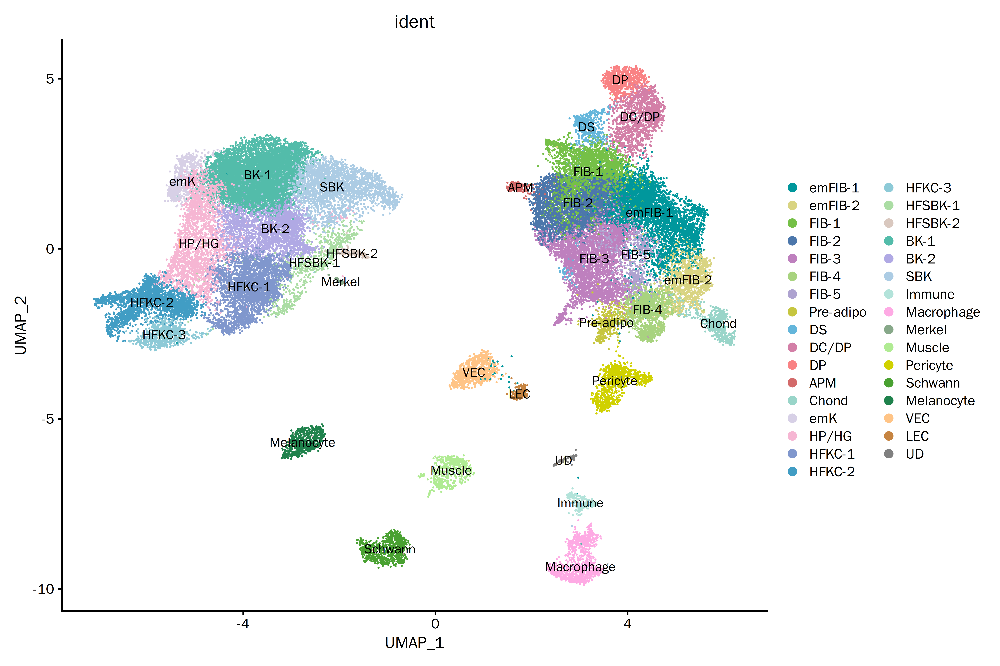

In [17]:
DimPlot(skin, label = TRUE, group.by = "ident", cols = cluster_colors)

In [ ]:
options(repr.plot.width=10, repr.plot.height=10)
DimPlot(object = skin, label = TRUE, pt.size = 0.5, label.size=5, cols = use_color,) + guides(color = guide_legend(override.aes = list(size=5), ncol=5) ) +theme_void(base_size = 25) +NoAxes() + theme(legend.position = 'bottom')


In [ ]:
ggsave("./Fig1_rxiv/250219.mainUMAP-2.png",  width =10, height =10, units = 'in')

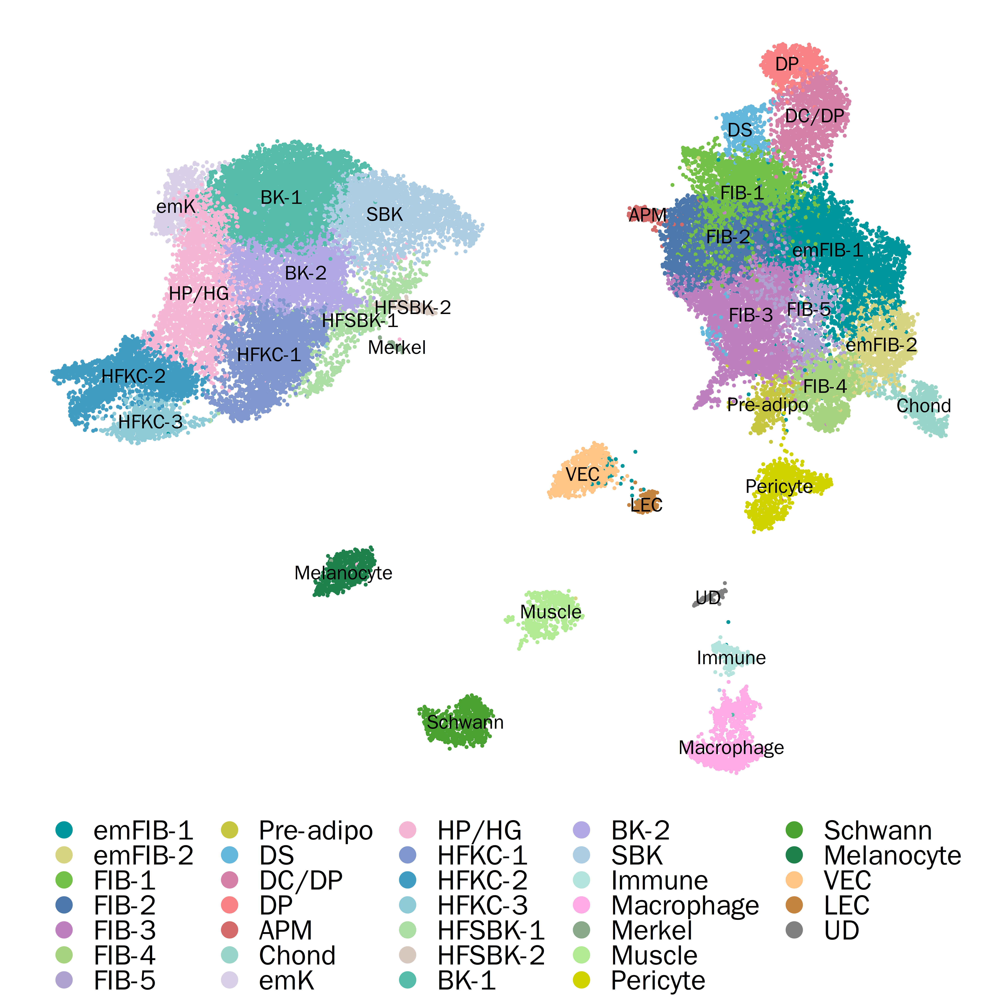

In [21]:
options(repr.plot.width=10, repr.plot.height=10, dpi=300)
DimPlot(object = skin, label = TRUE, pt.size = 0.5, label.size=5, cols = use_color) + guides(color = guide_legend(override.aes = list(size=5), ncol=5) ) +theme_void(base_size = 25) +NoAxes() + theme(legend.position = 'bottom')


In [22]:
ggsave("./Fig1_rxiv/250304.mainUMAP_forlabel.svg", width =10, height =10, units = 'in')

In [24]:
cluster_colors

APM       BK-1       BK-2      Chond      DC/DP         DP         DS 
 "#00979c"  "#d9d482"  "#75c047"  "#4c77ab"  "#be80be"  "#a8d37f"  "#aea3d0" 
   emFIB-1    emFIB-2        emK      FIB-1      FIB-2      FIB-3      FIB-4 
 "#c6c640"  "#64b6db"  "#d37fa7"  "#f98284"  "#d36a6a"  "#99d5c9"  "#d7d0e6" 
     FIB-5     HFKC-1     HFKC-2     HFKC-3    HFSBK-1    HFSBK-2      HP/HG 
 "#f6b6d3"  "#8097cd"  "#419dc4"  "#8dcad7"  "#abdda4"  "#d9c8bf"  "#53bcaa" 
    Immune        LEC Macrophage Melanocyte     Merkel     Muscle   Pericyte 
 "#b0a9e4"  "#accce4"  "#b3e3da"  "#feaae4"  "#87a889"  "#b0eb93"  "#d0d100" 
 Pre-adipo        SBK    Schwann         UD        VEC 
 "#49a131"  "#1f824c"  "#ffc486"  "#c68441"  "#808080"

In [ ]:
#https://github.com/stuart-lab/signac/issues/1353  <-- how to color plot

In [57]:
options(repr.plot.width = 7, repr.plot.height = 3.5, repr.plot.res = 300)

In [58]:
p <- PlotFootprint(skin, features = c("Twist2"), label.top = 3,)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)

Warning message:
"Removed 16830 rows containing missing values (`geom_label_repel()`)."


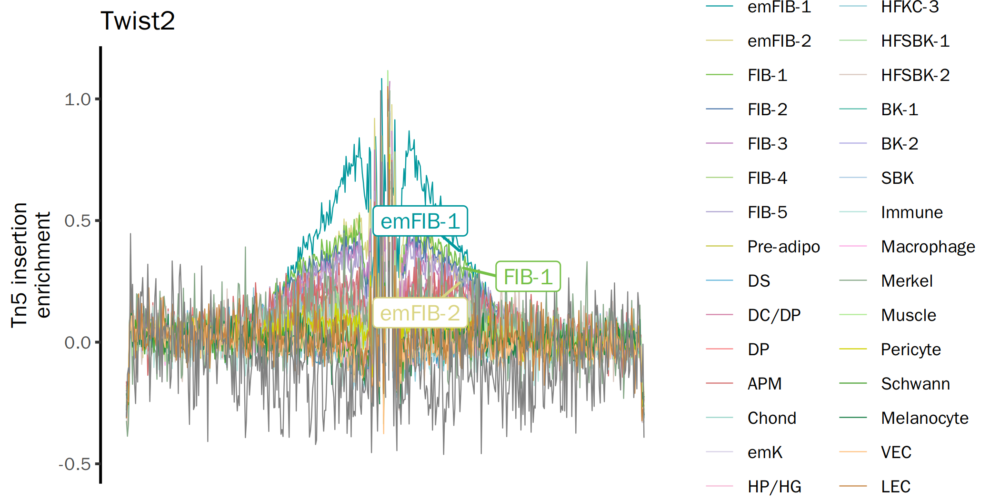

In [59]:
p[[1]][[1]]

In [47]:
options(repr.plot.width = 7, repr.plot.height = 1.5, repr.plot.res = 300)

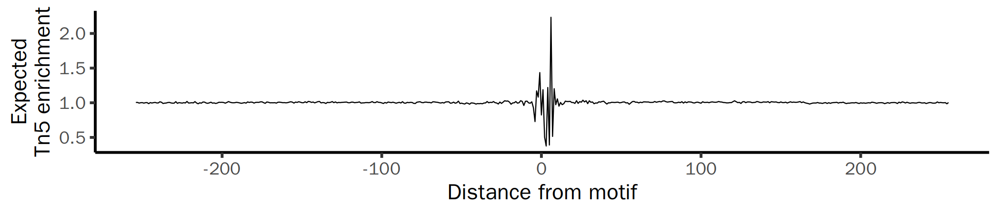

In [48]:
p[[1]][[2]]

In [56]:
library(patchwork)

combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250219.Twist2_combined_footprint_plot.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16830 rows containing missing values (`geom_label_repel()`)."


In [60]:
p <- PlotFootprint(skin, features = c("Stat5a"), label.top = 3)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)

Warning message:
"Removed 16896 rows containing missing values (`geom_label_repel()`)."


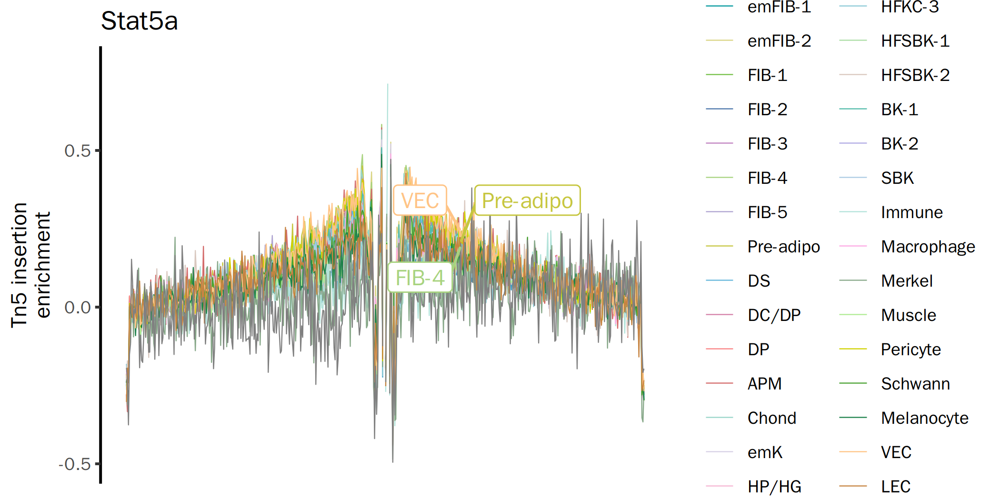

In [61]:
p[[1]][[1]]

In [62]:
combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250219.stat5a_combined_footprint_plot.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16896 rows containing missing values (`geom_label_repel()`)."


In [119]:
ggsave("./Fig3_rxiv/241028.footprint.stat5a.png", device=grDevices::png, width =10, height =5, units = 'in')

Warning message:
"Removed 16896 rows containing missing values (`geom_label_repel()`)."


In [63]:
p <- PlotFootprint(skin, features = c("CEBPA"), label.top = 5)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)

Warning message:
"Removed 16962 rows containing missing values (`geom_label_repel()`)."


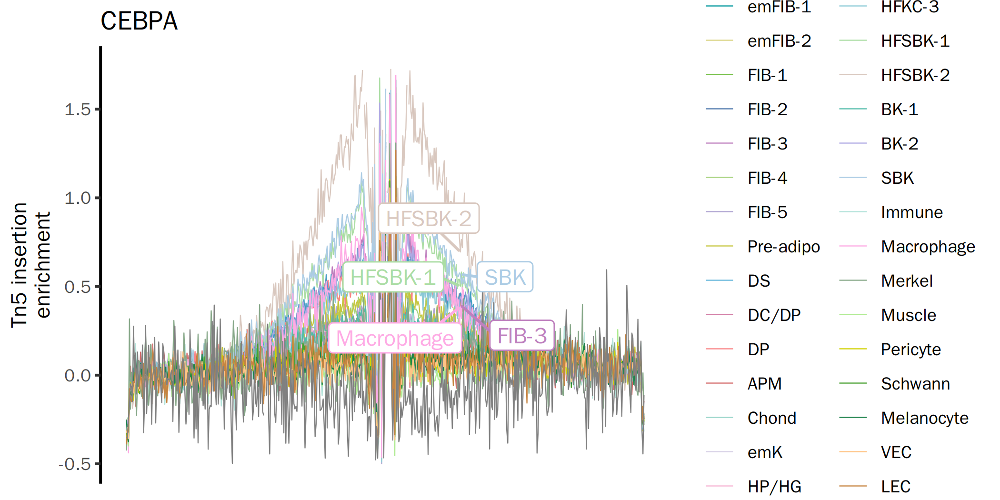

In [64]:
p[[1]][[1]]

In [65]:
library(patchwork)

combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250219.cebpa_combined_footprint_plot.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16962 rows containing missing values (`geom_label_repel()`)."


In [190]:
options(repr.plot.width = 20, repr.plot.height = 10, repr.plot.res = 100)

In [ ]:
# to check whether sox9 has a high binding activity in HFKC as well

In [193]:
p <- PlotFootprint(skin, features = c("SOX9"), label.top = 8)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)

Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."
Warning message:
"ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


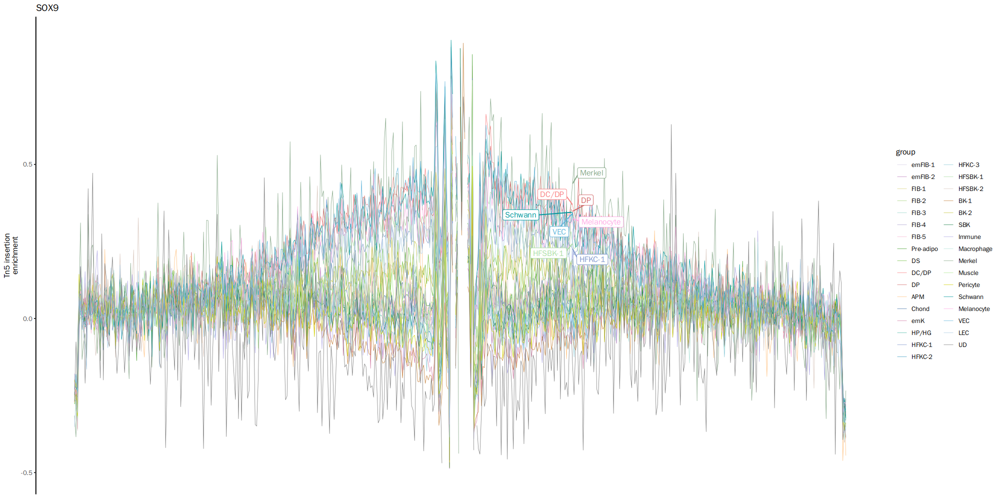

In [194]:
p[[1]][[1]]

In [182]:
ggsave("./Fig3_rxiv/241028.footprint.sox9.png", device=grDevices::png, width =10, height =5, units = 'in')

Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."


In [145]:
options(repr.plot.width = 7.5, repr.plot.height = 5, repr.plot.res = 300)

Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."


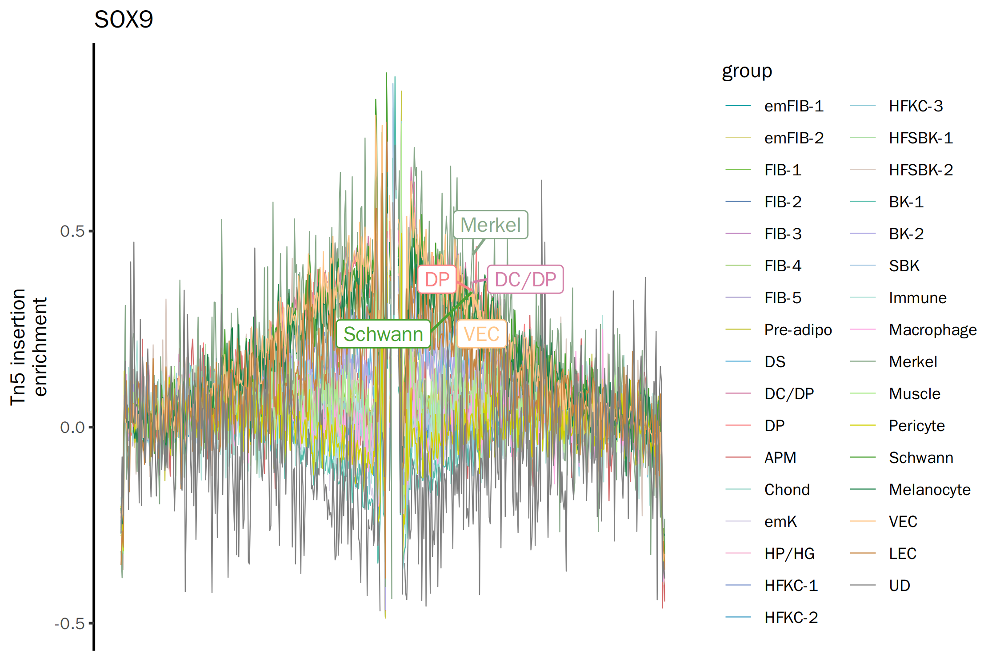

In [146]:
p <- PlotFootprint(skin, features = c("SOX9"), label.top = 5, label=TRUE)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)
p[[1]][[1]]

In [147]:
library(patchwork)

combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250219.Sox9_combined_footprint_plot-3.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."


Warning message:
"Removed 16995 rows containing missing values (`geom_label_repel()`)."


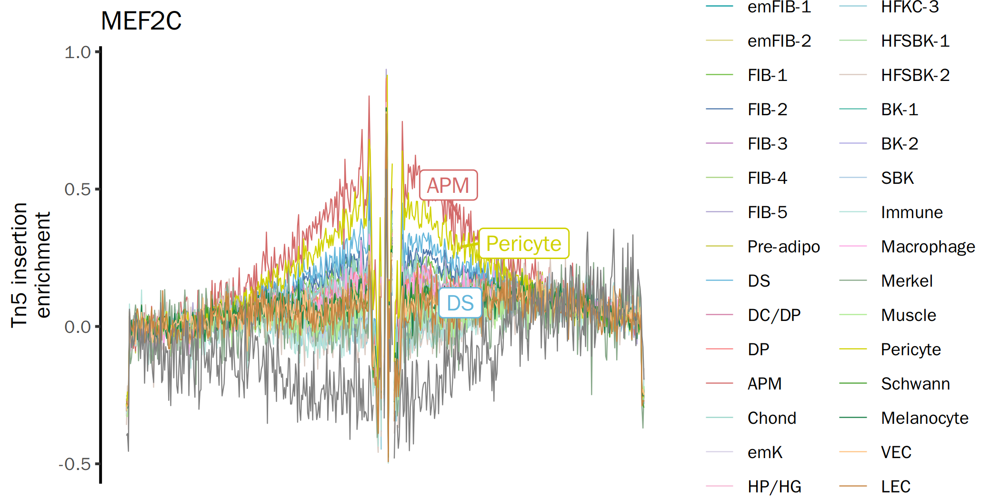

In [71]:
p <- PlotFootprint(skin, features = c("MEF2C"), label.top = 3, label=TRUE)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)
p[[1]][[1]]

In [72]:
library(patchwork)

combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250219.mef2c_combined_footprint_plot.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16995 rows containing missing values (`geom_label_repel()`)."


Warning message:
"Removed 16995 rows containing missing values (`geom_label_repel()`)."


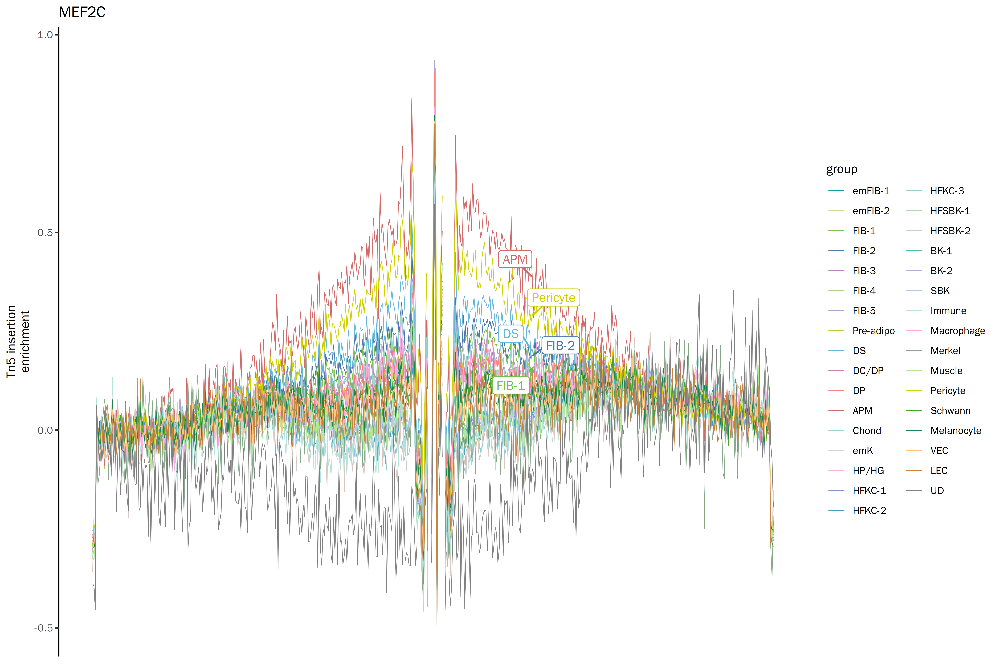

In [20]:
p <- PlotFootprint(skin, features = c("MEF2C"), label.top = 5, label=TRUE)
p[[1]][[1]] <- p[[1]][[1]] + scale_color_manual(values=cluster_colors)
p[[1]][[1]]

In [21]:
library(patchwork)

combined_plot <- p[[1]][[1]] / p[[1]][[2]] + 
  plot_layout(heights = c(6, 1))

ggsave("250226.mef2c_combined_footprint_plot.svg", combined_plot, width = 7.5, height = 5, dpi = 300)

Warning message:
"Removed 16995 rows containing missing values (`geom_label_repel()`)."


In [ ]:
#check individual plots of stat5a and sox9

In [20]:
options(repr.plot.width = 14, repr.plot.height = 7, repr.plot.res = 600)

In [30]:
p <- PlotFootprint(skin, features = c("Stat5a"), label.top = 3, split.by="label")

Warning message in PlotFootprint(skin, features = c("Stat5a"), label.top = 3, split.by = "label"):
"Cannot plot expected enrichment with split.by"


Warning message:
"Removed 16896 rows containing missing values (`geom_label_repel()`)."


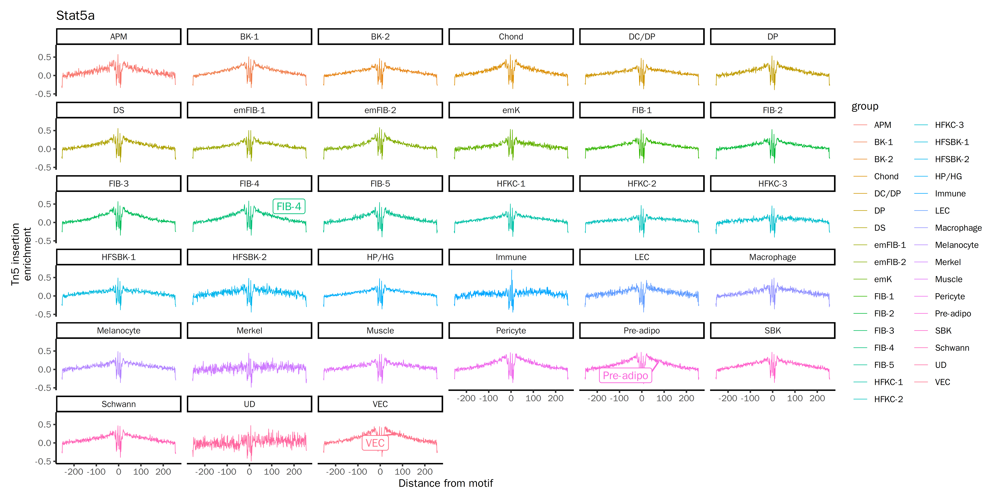

In [31]:
p

In [32]:
ggsave("./Fig3_rxiv/250115.splitby.stat5a.png", device=grDevices::png, width =14, height =7, units = 'in', dpi=600)

Warning message:
"Removed 16896 rows containing missing values (`geom_label_repel()`)."


In [25]:
p <- PlotFootprint(skin, features = c("SOX9"), label.top = 8, split.by="label")


Warning message in PlotFootprint(skin, features = c("SOX9"), label.top = 8, split.by = "label"):
"Cannot plot expected enrichment with split.by"


Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."


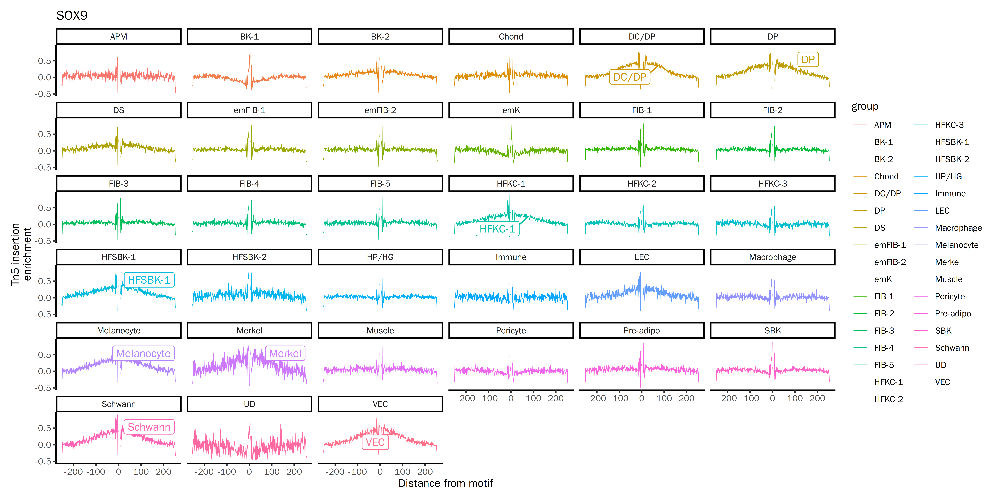

In [26]:
p

In [27]:
ggsave("./Fig3_rxiv/250115.splitby.sox9.png", device=grDevices::png, width =14, height =7, units = 'in')

Warning message:
"Removed 16797 rows containing missing values (`geom_label_repel()`)."


In [ ]:
# Gather the footprinting information for the set of motifs
skin <- Footprint(
  object = skin,
  motif.name = c(
    "MXI1", "Bhlha15", "NEUROD2", "TCF21(var.2)", "NEUROG1", "BHLHE23", 
    "OLIG1", "OLIG3", "Twist2", "BHLHE22", "TWIST1", "HAND2", "Ptf1a", 
    "ZBTB18", "ATOH7", "Stat5a", "Stat5a::Stat5b", "STAT1", "STAT3", 
    "Stat4", "Hand1::Tcf3", "NFATC2", "NFATC1", "ZBTB26", "KLF4", "KLF5", 
    "RUNX1", "TEAD3", "KLF9", "ARGFX", "NKX6-2", "LMX1A", "PRRX1", "Lhx4", 
    "SOX8", "SOX9", "Sox6", "PHOX2A", "SOX13", "MEF2A", "MEF2D", "MEF2C", 
    "MEF2B", "SRF", "NFAT5", "NFATC3", "NFATC4", "CTCF", "CTCFL", "TP73", 
    "NRF1", "YY2", "TCF7L2", "TCF7", "LEF1", "TP63", "GRHL2", "MEOX1", 
    "EMX2", "EVX1", "EVX2", "GBX1", "HOXB7", "HOXA1", "HOXA5", "HOXB5", 
    "CEBPB", "FOXE1", "CEBPE", "CEBPD", "CEBPG", "PPARA::RXRA", "CEBPA", 
    "CEBPG(var.2)", "HLF", "BACH1", "FOSL2", "Smad2::Smad3", "JUN(var.2)", 
    "BACH2", "TP53", "ZEB1", "Rbpjl", "FOS::JUN", "FOS::JUND", "ELK3", 
    "ELK1", "ETV3", "ETV5", "FEV", "ELF1", "ELF3", "ELF5", "ETV4", "ETV1", 
    "POU4F2", "POU4F3", "POU4F1", "MYOD1", "HNF1B", "ASCL1", "Ascl2", 
    "NHLH1", "MSC", "MYOG", "Ebf2", "EBF3", "EBF1", "SOX4", "SOX10", 
    "NR2F2", "NR2F1", "TFEB", "TFE3", "USF2", "MITF", "USF1", "ETV2", 
    "IKZF1", "GABPA", "BHLHE41", "YY1"
  ),
  genome = BSgenome.Mmusculus.UCSC.mm10
)

Computing observed Tn5 insertions per base

Computing base composition at motif sites

Computing expected Tn5 insertions per base

Finding + strand cut sites

Finding - strand cut sites

Computing observed Tn5 insertions per base

Computing base composition at motif sites

Computing expected Tn5 insertions per base

Finding + strand cut sites

Finding - strand cut sites

Computing observed Tn5 insertions per base

Computing base composition at motif sites

Computing expected Tn5 insertions per base

Finding + strand cut sites

Finding - strand cut sites

Computing observed Tn5 insertions per base

Computing base composition at motif sites

Computing expected Tn5 insertions per base

Finding + strand cut sites

Finding - strand cut sites

Computing observed Tn5 insertions per base

Computing base composition at motif sites

Computing expected Tn5 insertions per base

Finding + strand cut sites

Finding - strand cut sites

Computing observed Tn5 insertions per base

Computing base compos

In [39]:
saveRDS(skin, "./RDS/241023.E13_PD4_integrated.2-10.reference.motif.chromvar.newcluster.footprint.rds")